In [75]:
import sys
import numpy as np
import pandas as pd
sys.path.append('../src')
from utils import plot_face, get_parameters
from model import run_inverted_linreg, run_inverted_logreg


N = 848  # number of unique stimuli
n_v = 31049  # number of vertices

# Load vertices, both static and dynamic
v = np.load('../data/vertices.npz')['v']
mean_face = v[:, 0, :, :].mean(axis=0)  # for plotting
tris = np.load('../data/tris.npy') - 1  # triangles

tpe = 'static'

In [76]:
coef = pd.read_csv(f'../results/validation/target-emotion_fs-vertexPCA_type-{tpe}_coefs.tsv', sep='\t', index_col=0)
v_pca = pd.read_csv(f'../data/features/vertexPCA_type-{tpe}.tsv', sep='\t', index_col=0).to_numpy()

with np.load(f'../results/pca/pca_type-{tpe}_weights.npz') as data:
    # "vd" stands for "vertex difference"
    mu_, w_ = data['mu'], data['W']
    if tpe == 'static':
        w_ = w_[:49, :]

if tpe == 'static':
    v_ = v[:, 0, :, :]
    v_pca = v_pca[:, :49]
else:
    v_ = v[:, 1, :, :]

In [77]:
sub = 1
alpha_hat, beta_hat, Z = get_parameters('average', coef)
if tpe == 'static':
    beta_hat = beta_hat[:, :49]

mod_map, trace = run_inverted_logreg(v_pca, beta_hat, alpha_hat, return_trace=True)

../src/model.py:131: FutureWarning:

In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [X48_, X47_, X46_, X45_, X44_, X43_, X42_, X41_, X40_, X39_, X38_, X37_, X36_, X35_, X34_, X33_, X32_, X31_, X30_, X29_, X28_, X27_, X26_, X25_, X24_, X23_, X22_, X21_, X20_, X19_, X18_, X17_, X16_, X15_, X14_, X13_, X12_, X11_, X10_, X9_, X8_, X7_, X6_, X5_, X4_, X3_, X2_, X1_, X0_]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 27 seconds.


In [89]:
def run_inverted_logreg(X, beta_hat, alpha_hat, standardize=True, return_trace=False):

    if standardize:
        X = X / X.std(axis=0)
        
    X_min, X_max = X.min(axis=0), X.max(axis=0)
    
    P = X.shape[1]
    K = alpha_hat.size
    with pm.Model() as model:

        X_ = tt.stack([pm.Uniform(f'X{i}_', lower=X_min[i], upper=X_max[i], shape=K)
                       for i in range(P)], axis=1)
        mu_ = tt.dot(X_, beta_hat.T) + alpha_hat
        py_ = pm.Deterministic('py_', tt.nnet.softmax(mu_))
        y_ = pm.Categorical('y_', p=py_, observed=range(K))

        mod_map = pm.find_MAP(model=model)
        if return_trace:
            trace = pm.sample(draws=10000)
            return mod_map, trace
        else:
            return mod_map

In [90]:
mod_map, trace = run_inverted_logreg(v_pca, beta_hat, alpha_hat, return_trace=True)

<ipython-input-89-986d9d983208>:20: FutureWarning:

In v4.0, pm.sample will return an `arviz.InferenceData` object instead of a `MultiTrace` by default. You can pass return_inferencedata=True or return_inferencedata=False to be safe and silence this warning.

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [X48_, X47_, X46_, X45_, X44_, X43_, X42_, X41_, X40_, X39_, X38_, X37_, X36_, X35_, X34_, X33_, X32_, X31_, X30_, X29_, X28_, X27_, X26_, X25_, X24_, X23_, X22_, X21_, X20_, X19_, X18_, X17_, X16_, X15_, X14_, X13_, X12_, X11_, X10_, X9_, X8_, X7_, X6_, X5_, X4_, X3_, X2_, X1_, X0_]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 128 seconds.


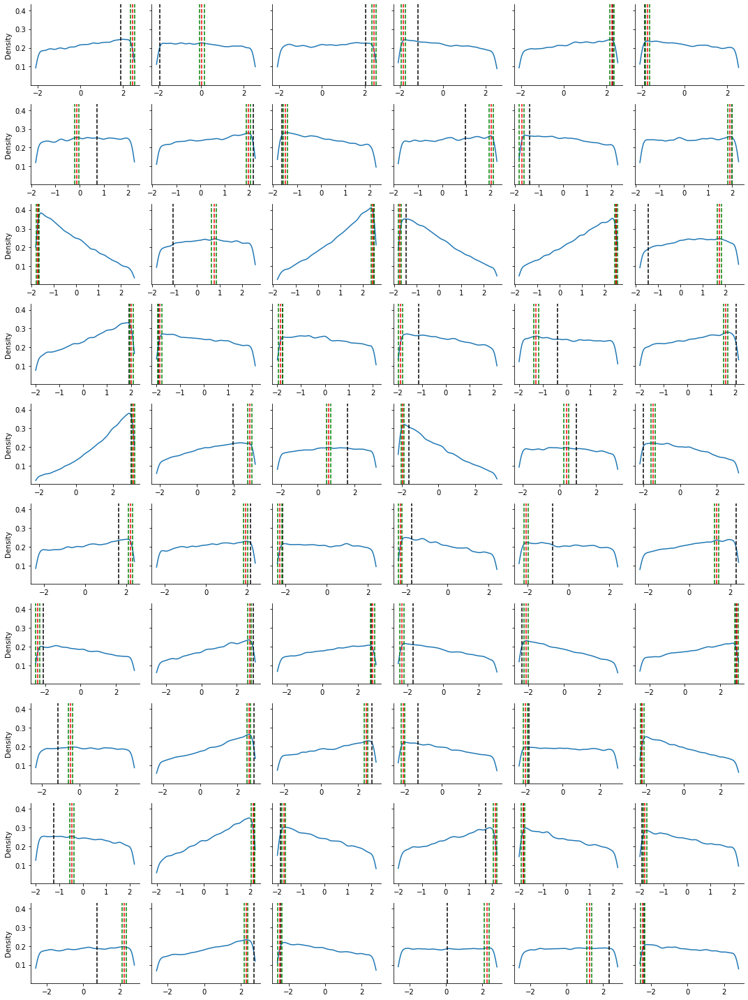

In [91]:
import pymc3 as pm
import matplotlib.pyplot as plt
import seaborn as sns

v_pca_std = v_pca / v_pca.std(axis=0)
fig, axes = plt.subplots(nrows=10, ncols=6, figsize=(15, 20), sharex=False, sharey=True)
for i in range(10):
    minn, maxx = v_pca_std.min(axis=0), v_pca_std.max(axis=0)
    for ii in range(6):
        sns.kdeplot(trace[f'X{i}_'][:, ii], ax=axes[i, ii], clip=(minn[i], maxx[i]), bw_adjust=0.75)
        #sns.histplot(trace[f'X{i}_'][:, ii], ax=axes[i, ii])
        axes[i, ii].axvline(mod_map[f'X{i}_'][ii], ls='--', c='k')
        #sns.kdeplot(v_pca_std[:, i], ax=axes[i, ii], clip=(minn[i], maxx[i]))
        hdi = pm.stats.hdi(trace[f'X{i}_'][:, ii], hdi_prob=0.05)
        axes[i, ii].axvline(hdi[0], ls='--', c='g')
        axes[i, ii].axvline(hdi[1], ls='--', c='g')
        axes[i, ii].axvline(hdi.mean(), ls='--', c='r')
        
sns.despine()
fig.tight_layout()

In [92]:
X_map = np.zeros((6, 49))
for i in range(49):
    for ii in range(6):
        X_map[ii, i] = pm.stats.hdi(trace[f'X{i}_'][:, ii], hdi_prob=0.1).mean()

In [96]:
S_emo = ((X_map * v_pca.std(axis=0)) @ w_).reshape((X_map.shape[0], n_v, 3))
overlay_emo = S_emo / v_.std(axis=0)
overlay_emo[np.isnan(overlay_emo)] = 0
fig = plot_face(mean_face + S_emo[0, :, :], tris, overlay=overlay_emo[0, :, :], cmax=4, cmin=-4, threshold=0.1,
                col_titles=['X', 'Y', 'Z'])
fig.show()